<a href="https://colab.research.google.com/github/aarsanjani/meansquares/blob/master/version2/feature_engineering/NY_Labeling_CDC_Guideline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Goal

* This colab is for labeling CA data from combined datasets and maryland intertia dataset following CDC guideline 



In [2]:
# Task 

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
import pandas as pd
import seaborn as sns
from sklearn import preprocessing
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler as ss
import itertools
from scipy import linalg
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import export_graphviz
import numpy as np
import matplotlib.pyplot as plt

In [5]:
!pip install wget
import wget

  Created wheel for wget: filename=wget-3.2-cp36-none-any.whl size=9682 sha256=e2a7bc7bc2bbd6265a5b15a2ad0b277474dbed5c02a1d6e23ff78d0197df1b2c
  Stored in directory: /root/.cache/pip/wheels/40/15/30/7d8f7cea2902b4db79e3fea550d7d7b85ecb27ef992b618f3f
Successfully built wget


In [6]:
!ls  '/content/drive/Shared drives/CMPE 295- Master Project/projectdata-2021'

 CA_alldatasets_Feb05.csv
 CA_alldatasets_Jan13.csv
 CA_CombinedData_Labeled_CDCGuideline_Feb05.csv
 CA_CombinedData_Labeled_CDCGuideline_Feb06.csv
 CA_CombinedData_Labeled_CDCGuideline_Jan15.csv
 CA_combined_Feb04.csv
 CA_CovidDataJan10.csv
 CA_GoogleMobilityDataJan10.csv
 CA_MarylandData_Labeled_CDCGuideline_Feb05.csv
 CA_MarylandData_Labeled_CDCGuideline_Feb06.csv
 CA_MarylandData_Labeled_CDCGuideline_Jan15.csv
 CA_processedMarylandData_Feb04.csv
 CA_processedMarylandData_Feb05.csv
 CA_processedMarylandData_Jan11.csv
 CA_SocialDistancingDataJan10.csv
 CA_socialDistancingInertiaData_Feb04.csv
 computed_CA_mobility_data.csv
 data-mask_for_all.csv
 election_results_2021.csv
 maryland_inertia_data_allstates_Feb04.csv
 maryland_inertia_data_allstates_Feb05.csv
 maryland_inertia_data_allstates_Jan11.csv
 maryland_inertia_raw_dec28_2020.csv
 Mask_Rule_Feb05.csv
 Mask_Rule_Jan10.csv
 NY_alldatasets_Jan13.csv
 NY_CombinedData_Labeled_CDCGuideline_Jan15.csv
 NY_CovidDataJan10.csv
 NY_GoogleMo

### Location

In [7]:
location = '/content/drive/Shared drives/CMPE 295- Master Project/projectdata-2021/'

# Load Combined Dataset

## Data Preprocessing

In [8]:
CA_combined_data = pd.read_csv(location+'NY_alldatasets_Jan13.csv',low_memory=False)
CA_combined_data.head()

,Date,Province_State,FIPS,New cases,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
0,2020-03-01,New York,36001,0,Albany County,305506,0,2.616,54,10.0,13.0,19.0,4.0,7.0,-1.0
1,2020-03-02,New York,36001,0,Albany County,305506,0,4.680,97,11.0,15.0,29.0,5.0,3.0,0.0
2,2020-03-03,New York,36001,0,Albany County,305506,0,4.778,100,8.0,15.0,41.0,8.0,3.0,-1.0
3,2020-03-04,New York,36001,0,Albany County,305506,0,4.486,93,7.0,8.0,6.0,2.0,3.0,0.0
4,2020-03-05,New York,36001,0,Albany County,305506,0,5.129,107,5.0,13.0,18.0,2.0,3.0,-1.0


## 'New Cases/100k population'

In [9]:
CA_combined_data['New Cases/100k population'] = CA_combined_data['New cases']*100000/ CA_combined_data['population']
CA_combined_data.tail(2)

,Date,Province_State,FIPS,New cases,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,New Cases/100k population
17736,2021-01-04,New York,36123,15,Yates County,24913,1,2.325,33,NaN,8.0,NaN,NaN,-16.0,8.0,60.209529
17737,2021-01-05,New York,36123,11,Yates County,24913,1,1.719,24,NaN,8.0,NaN,NaN,-16.0,8.0,44.153655


## Computing rolling average

In [10]:
CA_combined_data.columns

Index(['Date', 'Province_State', 'FIPS', 'New cases', 'County Name',
       'population', 'mask_rule_active', 'm50', 'm50_index',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline',
       'New Cases/100k population'],
      dtype='object')

In [11]:
col_idx = CA_combined_data.columns.get_loc("New Cases/100k population")
print(col_idx)

15


15 no column  = New Cases/100k population

In [12]:
CA_combined_data.iloc[:,col_idx]

0         0.000000
1         0.000000
2         0.000000
3         0.000000
4         0.000000
           ...    
17733    84.293341
17734    68.237466
17735    72.251435
17736    60.209529
17737    44.153655
Name: New Cases/100k population, Length: 17738, dtype: float64

### Filter CA

In [13]:
CA_combined_data = CA_combined_data.loc[CA_combined_data['Province_State'] == 'New York']
CA_combined_data.reset_index(drop=True)

,Date,Province_State,FIPS,New cases,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,New Cases/100k population
0,2020-03-01,New York,36001,0,Albany County,305506,0,2.616,54,10.0,13.0,19.0,4.0,7.0,-1.0,0.000000
1,2020-03-02,New York,36001,0,Albany County,305506,0,4.680,97,11.0,15.0,29.0,5.0,3.0,0.0,0.000000
2,2020-03-03,New York,36001,0,Albany County,305506,0,4.778,100,8.0,15.0,41.0,8.0,3.0,-1.0,0.000000
3,2020-03-04,New York,36001,0,Albany County,305506,0,4.486,93,7.0,8.0,6.0,2.0,3.0,0.0,0.000000
4,2020-03-05,New York,36001,0,Albany County,305506,0,5.129,107,5.0,13.0,18.0,2.0,3.0,-1.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17733,2021-01-01,New York,36123,21,Yates County,24913,1,0.756,10,NaN,NaN,NaN,NaN,-73.0,NaN,84.293341
17734,2021-01-02,New York,36123,17,Yates County,24913,1,2.683,38,NaN,NaN,NaN,NaN,-12.0,NaN,68.237466
17735,2021-01-03,New York,36123,18,Yates County,24913,1,0.758,10,NaN,NaN,NaN,NaN,-3.0,NaN,72.251435
17736,2021-01-04,New York,36123,15,Yates County,24913,1,2.325,33,NaN,8.0,NaN,NaN,-16.0,8.0,60.209529


In [14]:
CA_combined_data.columns

Index(['Date', 'Province_State', 'FIPS', 'New cases', 'County Name',
       'population', 'mask_rule_active', 'm50', 'm50_index',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline',
       'New Cases/100k population'],
      dtype='object')

old

['Date', 'Province_State', 'FIPS','County Name','population',
                           'retail and recreation','grocery and pharmacy', 'parks', 'transit stations', 'workplaces',
       'residential', 'driving', 'm50', 'm50_index', 'population_density',
       'mask_rule_active', 'mask_wearing_percent', 'New cases',
       'New Cases/100k population', 'countyFIPS', 'State',
       'county_population','rolling_avg_new_cases/100k']

In [15]:
df = pd.DataFrame(columns=['Date', 'Province_State', 'FIPS','County Name','population',
                           'mask_rule_active', 'm50', 'm50_index',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline',
       'New Cases/100k population','rolling_avg_new_cases/100k'])


In [16]:
col_idx = CA_combined_data.columns.get_loc("New Cases/100k population")
print(col_idx)

15


In [17]:
CA_counties = CA_combined_data['County Name'].unique()

for county in CA_counties:
  county_data = CA_combined_data[CA_combined_data['County Name'] == county]
  #print(county_data.iloc[:,15])
  county_data['rolling_avg_new_cases/100k'] = county_data.iloc[:,col_idx].rolling(window=7).mean()
  df = df.append(county_data)

df.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Date,Province_State,FIPS,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,New Cases/100k population,rolling_avg_new_cases/100k,New cases
0,2020-03-01,New York,36001,Albany County,305506,0,2.616,54,10.0,13.0,19.0,4.0,7.0,-1.0,0.0,NaN,0.0
1,2020-03-02,New York,36001,Albany County,305506,0,4.680,97,11.0,15.0,29.0,5.0,3.0,0.0,0.0,NaN,0.0
2,2020-03-03,New York,36001,Albany County,305506,0,4.778,100,8.0,15.0,41.0,8.0,3.0,-1.0,0.0,NaN,0.0
3,2020-03-04,New York,36001,Albany County,305506,0,4.486,93,7.0,8.0,6.0,2.0,3.0,0.0,0.0,NaN,0.0
4,2020-03-05,New York,36001,Albany County,305506,0,5.129,107,5.0,13.0,18.0,2.0,3.0,-1.0,0.0,NaN,0.0


In [18]:
print(df.shape)
CA_combined_data.shape

(17738, 17)


(17738, 16)

In [19]:
CA_combined_data = df.copy()
CA_combined_data

,Date,Province_State,FIPS,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,New Cases/100k population,rolling_avg_new_cases/100k,New cases
0,2020-03-01,New York,36001,Albany County,305506,0,2.616,54,10.0,13.0,19.0,4.0,7.0,-1.0,0.000000,NaN,0.0
1,2020-03-02,New York,36001,Albany County,305506,0,4.680,97,11.0,15.0,29.0,5.0,3.0,0.0,0.000000,NaN,0.0
2,2020-03-03,New York,36001,Albany County,305506,0,4.778,100,8.0,15.0,41.0,8.0,3.0,-1.0,0.000000,NaN,0.0
3,2020-03-04,New York,36001,Albany County,305506,0,4.486,93,7.0,8.0,6.0,2.0,3.0,0.0,0.000000,NaN,0.0
4,2020-03-05,New York,36001,Albany County,305506,0,5.129,107,5.0,13.0,18.0,2.0,3.0,-1.0,0.000000,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17733,2021-01-01,New York,36123,Yates County,24913,1,0.756,10,NaN,NaN,NaN,NaN,-73.0,NaN,84.293341,52.181592,21.0
17734,2021-01-02,New York,36123,Yates County,24913,1,2.683,38,NaN,NaN,NaN,NaN,-12.0,NaN,68.237466,52.755016,17.0
17735,2021-01-03,New York,36123,Yates County,24913,1,0.758,10,NaN,NaN,NaN,NaN,-3.0,NaN,72.251435,61.356377,18.0
17736,2021-01-04,New York,36123,Yates County,24913,1,2.325,33,NaN,8.0,NaN,NaN,-16.0,8.0,60.209529,63.076650,15.0


In [20]:
CA_combined_data[CA_combined_data['Date'] == '2020-08-01'].head(4)

,Date,Province_State,FIPS,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,New Cases/100k population,rolling_avg_new_cases/100k,New cases
151,2020-08-01,New York,36001,Albany County,305506,1,2.260,47,-33.0,-10.0,NaN,-27.0,-14.0,1.0,3.927910,3.600584e+00,12.0
451,2020-08-01,New York,36003,Allegany County,46091,1,5.929,105,-6.0,14.0,NaN,NaN,-12.0,NaN,0.000000,3.806479e-16,0.0
745,2020-08-01,New York,36007,Broome County,190488,1,2.238,49,-21.0,-4.0,NaN,1.0,-14.0,1.0,5.774642,6.149619e+00,11.0
1045,2020-08-01,New York,36009,Cattaraugus County,76117,1,4.348,79,-13.0,51.0,NaN,NaN,-13.0,0.0,0.000000,1.501448e+00,0.0


## clean data - fill NA 

In [21]:
CA_combined_data = CA_combined_data.fillna(0)
CA_combined_data.head(8)

,Date,Province_State,FIPS,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,New Cases/100k population,rolling_avg_new_cases/100k,New cases
0,2020-03-01,New York,36001,Albany County,305506,0,2.616,54,10.0,13.0,19.0,4.0,7.0,-1.0,0.0,0.0,0.0
1,2020-03-02,New York,36001,Albany County,305506,0,4.680,97,11.0,15.0,29.0,5.0,3.0,0.0,0.0,0.0,0.0
2,2020-03-03,New York,36001,Albany County,305506,0,4.778,100,8.0,15.0,41.0,8.0,3.0,-1.0,0.0,0.0,0.0
3,2020-03-04,New York,36001,Albany County,305506,0,4.486,93,7.0,8.0,6.0,2.0,3.0,0.0,0.0,0.0,0.0
4,2020-03-05,New York,36001,Albany County,305506,0,5.129,107,5.0,13.0,18.0,2.0,3.0,-1.0,0.0,0.0,0.0
5,2020-03-06,New York,36001,Albany County,305506,0,5.428,113,6.0,10.0,12.0,7.0,3.0,0.0,0.0,0.0,0.0
6,2020-03-07,New York,36001,Albany County,305506,0,3.992,83,12.0,12.0,78.0,11.0,6.0,-1.0,0.0,0.0,0.0
7,2020-03-08,New York,36001,Albany County,305506,0,2.550,53,9.0,13.0,186.0,7.0,2.0,-1.0,0.0,0.0,0.0


## Labeling: Apply CDC Guideline for all counties

https://edsource.org/2020/quick-guide-what-californias-color-coded-county-tracking-system-means-for-schools/639357

In [22]:
county_names = CA_combined_data['County Name'].unique()

In [23]:
CA_combined_data[CA_combined_data['County Name']== 'Albany County'].population.unique()[0]

305506

In [24]:
CA_combined_data[CA_combined_data['population'] < 300000]['County Name'].shape

(13838,)

* Widespread (purple): Counties with more than 7 daily new cases per 100,000 residents or higher than 8% positivity rate
* Substantial (red): 4 to 7 daily new cases per 100,000 residents or 5-8% positivity
* Moderate (orange): 1 to 3.9 daily new cases per 100,000 or 2-4.9% positivity
* Minimal (yellow): Less than 1 daily new case per 100,000 or less than 2% positivity

In [25]:
for county in county_names:
    print('county name: ',county)
    county_population = CA_combined_data[CA_combined_data['County Name']== county].population.unique()[0]
    county_data = CA_combined_data[CA_combined_data['County Name']== county]
    new_cases_100k_la_list = county_data['New Cases/100k population'].values
    #rolling_avg_new_cases/100k_list = county_data['rolling_avg_new_cases/100k'].values
    

    diffArr = np.diff(new_cases_100k_la_list)
    growth_values =[]
    growth_values.append(0.0) # making first value as 0, as np.diff leaves first values as NA
    
    growth_values.extend(diffArr)
    county_data['growth_values'] = growth_values

    minVal = np.min(growth_values)
    maxVal = np.max(growth_values)
    meanVal= np.mean(growth_values, axis=0)
    stdVal = np.std(growth_values, axis=0)

#implementing cdc guideline-CA color code
#Widespread (purple): Counties with more than 7 daily new cases per 100,000 residents or higher than 8% positivity rate
#Substantial (red): 4 to 7 daily new cases per 100,000 residents or 5-8% positivity
#Moderate (orange): 1 to 3.9 daily new cases per 100,000 or 2-4.9% positivity
#Minimal (yellow): Less than 1 daily new case per 100,000 or less than 2% positivity
    for index, row in (county_data.iterrows()):
      i = row['rolling_avg_new_cases/100k']
      '''
      if i > 7 :
        label = 'widespread'
      elif (i <= 7) and (i >= 4):
        label = 'substantial'
      elif (i < 4) and (i >= 1):
        label = 'moderate'
      elif i < 1 :
        label = 'minimal'
      '''
      #new labeling from CA
      if i > 77 :
        label = 'widespread'
      elif (i <= 77) and (i >= 27):
        label = 'substantial'
      elif (i < 27) and (i >= 7):
        label = 'moderate'
      elif i < 7 :
        label = 'minimal'    
    
      date = row['Date']
      #print(i,county, date, label)

      df_index = (CA_combined_data['County Name'] == county) & (CA_combined_data['Date'] == date) 
      #print(df_weekData)
      CA_combined_data.loc[df_index,'growth_label'] = label
    #break

county name:  Albany County


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


county name:  Allegany County
county name:  Broome County
county name:  Cattaraugus County
county name:  Cayuga County
county name:  Chautauqua County
county name:  Chemung County
county name:  Chenango County
county name:  Clinton County
county name:  Columbia County
county name:  Cortland County
county name:  Delaware County
county name:  Dutchess County
county name:  Erie County
county name:  Essex County
county name:  Franklin County
county name:  Fulton County
county name:  Genesee County
county name:  Greene County
county name:  Herkimer County
county name:  Jefferson County
county name:  Kings County
county name:  Lewis County
county name:  Livingston County
county name:  Madison County
county name:  Monroe County
county name:  Montgomery County
county name:  Nassau County
county name:  New York County
county name:  Niagara County
county name:  Oneida County
county name:  Onondaga County
county name:  Ontario County
county name:  Orange County
county name:  Orleans County
county

In [26]:
print(CA_combined_data[CA_combined_data['growth_label'] == 'widespread'].shape)
print(CA_combined_data[CA_combined_data['growth_label'] == 'substantial'].shape)
print(CA_combined_data[CA_combined_data['growth_label'] == 'moderate'].shape)
print(CA_combined_data[CA_combined_data['growth_label'] == 'minimal'].shape)


(268, 18)
(2180, 18)
(3052, 18)
(12238, 18)


In [27]:
#to show all rows
pd.set_option('display.max_rows', None)

In [28]:
CA_combined_data.groupby(['County Name','growth_label']).size().reset_index(name='row_count').sort_values(by=['County Name','growth_label','row_count'], ascending=False)

,County Name,growth_label,row_count
205,Yates County,substantial,18
204,Yates County,moderate,57
203,Yates County,minimal,200
202,Wyoming County,widespread,5
201,Wyoming County,substantial,36
200,Wyoming County,moderate,21
199,Wyoming County,minimal,232
198,Westchester County,widespread,17
197,Westchester County,substantial,72
196,Westchester County,moderate,66


## Verifying with plot

['minimal' 0 'moderate' 1 'substantial' 2 'widespread' 3]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


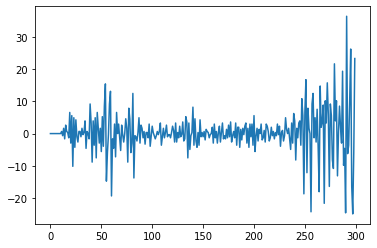

(4, 19)


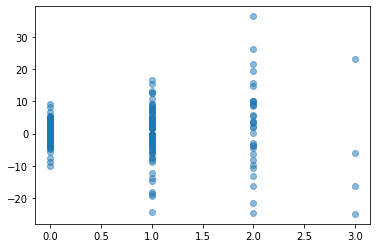

In [29]:
alameda_data = CA_combined_data[CA_combined_data['County Name'] == 'Albany County']

new_cases_100k_la_list = alameda_data['New Cases/100k population'].values
diffArr = np.diff(new_cases_100k_la_list)
growth_values =[]
growth_values.append(0.0) # making first value as 0, as np.diff leaves first values as NA
    
growth_values.extend(diffArr)

alameda_data['growth_code'] = alameda_data['growth_label'].astype('category').cat.codes
print(pd.unique(alameda_data[['growth_label', 'growth_code']].values.ravel()))
new_cases_100k_la_list = alameda_data['New Cases/100k population'].values
plt.plot(growth_values)
plt.show()
alameda_labelflat_growth = alameda_data[alameda_data['growth_label'] == 'widespread']
print(alameda_labelflat_growth.shape)
#alameda_labelflat_growth

N = 5
x = alameda_data['growth_code'].values
y = growth_values #alameda_data['New Cases/1k population'].values
colors = np.random.rand(N)
area = (30 * np.random.rand(N))**2  # 0 to 15 point radii

plt.scatter(x, y, alpha=0.5)
plt.show()


Using rolling_avg_new_cases/100k

['minimal' 0 'moderate' 1 'substantial' 2 'widespread' 3]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


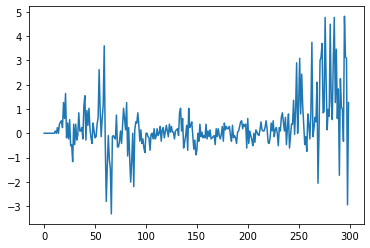

(4, 19)


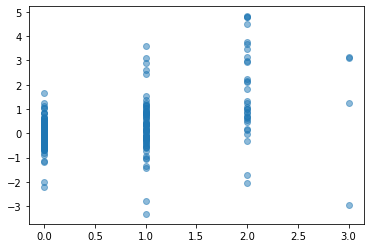

In [30]:
alameda_data = CA_combined_data[CA_combined_data['County Name'] == 'Albany County']

rollavg_new_cases_100k_la_list = alameda_data['rolling_avg_new_cases/100k'].values
diffArr = np.diff(rollavg_new_cases_100k_la_list)
growth_values =[]
growth_values.append(0.0) # making first value as 0, as np.diff leaves first values as NA
    
growth_values.extend(diffArr)

alameda_data['growth_code'] = alameda_data['growth_label'].astype('category').cat.codes
print(pd.unique(alameda_data[['growth_label', 'growth_code']].values.ravel()))
rollavg_new_cases_100k_la_list = alameda_data['rolling_avg_new_cases/100k'].values
plt.plot(growth_values)
plt.show()
alameda_labelflat_growth = alameda_data[alameda_data['growth_label'] == 'widespread']
print(alameda_labelflat_growth.shape)
#alameda_labelflat_growth

N = 5
x = alameda_data['growth_code'].values
y = growth_values #alameda_data['New Cases/1k population'].values
colors = np.random.rand(N)
area = (30 * np.random.rand(N))**2  # 0 to 15 point radii

plt.scatter(x, y, alpha=0.5)
plt.show()

## verifying Rolling average with visualizations -Los Angeles County

http://dashboard.publichealth.lacounty.gov/covid19_surveillance_dashboard/

In [31]:
CA_combined_data.Date.unique()

array(['2020-03-01', '2020-03-02', '2020-03-03', '2020-03-04',
       '2020-03-05', '2020-03-06', '2020-03-07', '2020-03-08',
       '2020-03-09', '2020-03-10', '2020-03-11', '2020-03-12',
       '2020-03-13', '2020-03-14', '2020-03-15', '2020-03-16',
       '2020-03-17', '2020-03-18', '2020-03-19', '2020-03-20',
       '2020-03-21', '2020-03-22', '2020-03-23', '2020-03-24',
       '2020-03-25', '2020-03-26', '2020-03-27', '2020-03-28',
       '2020-03-29', '2020-03-30', '2020-03-31', '2020-04-01',
       '2020-04-02', '2020-04-03', '2020-04-04', '2020-04-05',
       '2020-04-06', '2020-04-07', '2020-04-08', '2020-04-09',
       '2020-04-10', '2020-04-11', '2020-04-12', '2020-04-13',
       '2020-04-14', '2020-04-15', '2020-04-16', '2020-04-17',
       '2020-04-18', '2020-04-19', '2020-04-21', '2020-04-22',
       '2020-04-23', '2020-04-24', '2020-04-25', '2020-04-26',
       '2020-04-27', '2020-04-28', '2020-04-29', '2020-04-30',
       '2020-05-01', '2020-05-02', '2020-05-03', '2020-

In [32]:
date_list_aug = ['2020-08-01',
       '2020-08-02', '2020-08-03', '2020-08-04', '2020-08-05',
       '2020-08-06', '2020-08-07', '2020-08-08', '2020-08-09',
       '2020-08-10', '2020-08-11', '2020-08-12', '2020-08-13',
       '2020-08-14', '2020-08-15', '2020-08-16', '2020-08-17',
       '2020-08-18', '2020-08-19', '2020-08-20', '2020-08-21']

date_list = ['2020-07-01', '2020-07-02', '2020-07-03', '2020-07-04',
       '2020-07-05', '2020-07-06', '2020-07-07', '2020-07-08',
       '2020-07-09', '2020-07-10', '2020-07-11', '2020-07-12',
       '2020-07-13', '2020-07-14', '2020-07-15', '2020-07-16',
       '2020-07-17', '2020-07-18', '2020-07-19', '2020-07-20',
       '2020-07-21', '2020-07-22', '2020-07-23', '2020-07-24',
       '2020-07-25', '2020-07-26', '2020-07-27', '2020-07-28',
       '2020-07-29', '2020-07-30', '2020-07-31']

### ['minimal' 0 'moderate' 1 'substantial' 2 'widespread' 3]

widespread

In [33]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'widespread')]['Date'].unique()

array(['2021-01-02', '2021-01-03', '2021-01-04', '2021-01-05'],
      dtype=object)

substantial

In [34]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'substantial')]['Date'].unique()

array(['2020-11-22', '2020-11-24', '2020-11-25', '2020-11-26',
       '2020-11-27', '2020-11-28', '2020-11-29', '2020-11-30',
       '2020-12-01', '2020-12-02', '2020-12-03', '2020-12-04',
       '2020-12-05', '2020-12-06', '2020-12-07', '2020-12-08',
       '2020-12-09', '2020-12-10', '2020-12-19', '2020-12-20',
       '2020-12-21', '2020-12-22', '2020-12-23', '2020-12-24',
       '2020-12-25', '2020-12-26', '2020-12-27', '2020-12-28',
       '2020-12-29', '2020-12-30', '2020-12-31', '2021-01-01'],
      dtype=object)

moderate

In [35]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'moderate')]['Date'].unique()

array(['2020-04-10', '2020-04-11', '2020-04-12', '2020-04-13',
       '2020-04-14', '2020-04-15', '2020-04-16', '2020-04-17',
       '2020-04-18', '2020-04-19', '2020-04-21', '2020-04-22',
       '2020-04-23', '2020-04-24', '2020-04-25', '2020-04-26',
       '2020-04-27', '2020-04-28', '2020-04-29', '2020-04-30',
       '2020-05-01', '2020-05-02', '2020-05-03', '2020-05-04',
       '2020-05-05', '2020-05-06', '2020-05-07', '2020-05-08',
       '2020-05-09', '2020-05-10', '2020-05-11', '2020-05-12',
       '2020-05-13', '2020-05-14', '2020-05-15', '2020-05-16',
       '2020-05-18', '2020-05-19', '2020-05-20', '2020-05-21',
       '2020-05-22', '2020-05-23', '2020-05-24', '2020-05-25',
       '2020-10-24', '2020-10-25', '2020-10-26', '2020-10-27',
       '2020-10-28', '2020-10-29', '2020-10-30', '2020-10-31',
       '2020-11-01', '2020-11-02', '2020-11-03', '2020-11-04',
       '2020-11-05', '2020-11-06', '2020-11-07', '2020-11-08',
       '2020-11-09', '2020-11-10', '2020-11-11', '2020-

minimal

In [36]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'minimal')]['Date'].unique()

array(['2020-03-01', '2020-03-02', '2020-03-03', '2020-03-04',
       '2020-03-05', '2020-03-06', '2020-03-07', '2020-03-08',
       '2020-03-09', '2020-03-10', '2020-03-11', '2020-03-12',
       '2020-03-13', '2020-03-14', '2020-03-15', '2020-03-16',
       '2020-03-17', '2020-03-18', '2020-03-19', '2020-03-20',
       '2020-03-21', '2020-03-22', '2020-03-23', '2020-03-24',
       '2020-03-25', '2020-03-26', '2020-03-27', '2020-03-28',
       '2020-03-29', '2020-03-30', '2020-03-31', '2020-04-01',
       '2020-04-02', '2020-04-03', '2020-04-04', '2020-04-05',
       '2020-04-06', '2020-04-07', '2020-04-08', '2020-04-09',
       '2020-05-17', '2020-05-26', '2020-05-27', '2020-05-28',
       '2020-05-30', '2020-05-31', '2020-06-01', '2020-06-02',
       '2020-06-03', '2020-06-04', '2020-06-05', '2020-06-06',
       '2020-06-07', '2020-06-08', '2020-06-09', '2020-06-10',
       '2020-06-11', '2020-06-12', '2020-06-13', '2020-06-14',
       '2020-06-15', '2020-06-16', '2020-06-17', '2020-

### Other

In [37]:
los_angeles_county = CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & CA_combined_data['Date'].isin(date_list)]
print(los_angeles_county.shape)
los_angeles_county.head()

(31, 18)


,Date,Province_State,FIPS,County Name,population,mask_rule_active,m50,m50_index,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,New Cases/100k population,rolling_avg_new_cases/100k,New cases,growth_label
120,2020-07-01,New York,36001,Albany County,305506,1,3.234,67,-25.0,8.0,45.0,-32.0,-44.0,14.0,3.273258,2.197759,10.0,minimal
121,2020-07-02,New York,36001,Albany County,305506,1,3.401,71,-25.0,10.0,58.0,-32.0,-45.0,12.0,4.255236,2.291281,13.0,minimal
122,2020-07-03,New York,36001,Albany County,305506,1,2.795,58,-33.0,11.0,24.0,-44.0,-62.0,18.0,1.636629,2.150998,5.0,minimal
123,2020-07-04,New York,36001,Albany County,305506,1,2.290,47,-55.0,-18.0,0.0,-43.0,-24.0,2.0,4.909887,2.525085,15.0,minimal
124,2020-07-05,New York,36001,Albany County,305506,1,1.753,36,-40.0,-16.0,0.0,-36.0,-13.0,0.0,2.291281,2.571846,7.0,minimal


In [38]:
los_angeles_county.growth_label.unique()

array(['minimal'], dtype=object)

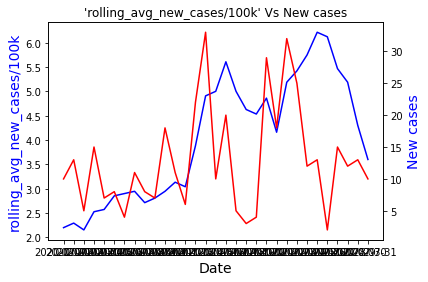

In [39]:
fig,ax = plt.subplots()
# make a plot
ax.plot(los_angeles_county.Date, los_angeles_county['rolling_avg_new_cases/100k'], color="blue")
# set x-axis label
ax.set_xlabel("Date",fontsize=14)
# set y-axis label
ax.set_ylabel("rolling_avg_new_cases/100k",color="blue",fontsize=14)
ax2=ax.twinx()
# make a plot with different y-axis using second axis object
ax2.plot(los_angeles_county.Date, los_angeles_county["New cases"],color="red")
ax2.set_ylabel("New cases",color="blue",fontsize=14)
plt.title("'rolling_avg_new_cases/100k' Vs New cases")
plt.xticks(rotation=90)
plt.show()


([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30],
 <a list of 31 Text major ticklabel objects>)

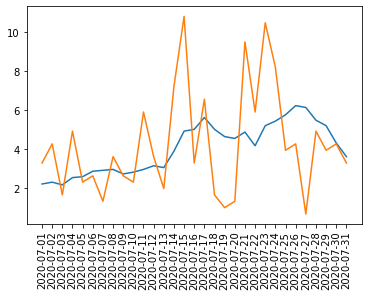

In [40]:
x = los_angeles_county['Date']
y1 = los_angeles_county['rolling_avg_new_cases/100k'] 
y2 = los_angeles_county['New Cases/100k population']


plt.plot(x,y1)
plt.plot(x,y2)
plt.xticks(rotation=90)

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


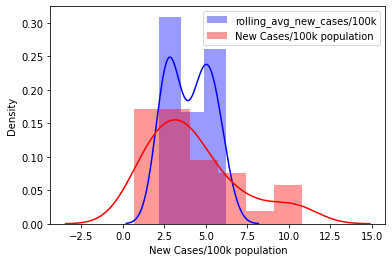

In [41]:
sns.distplot( (los_angeles_county['rolling_avg_new_cases/100k'] ) , color="blue", label='rolling_avg_new_cases/100k')
sns.distplot( los_angeles_county['New Cases/100k population'] , color="red", label='New Cases/100k population')
plt.legend()
 
plt.show()

## Riverside County

https://rivcoph.org/coronavirus

In [42]:
suffolk_county = CA_combined_data[CA_combined_data['County Name'] == 'Albany County']

### ['minimal' 0 'moderate' 1 'substantial' 2 'widespread' 3]

widespread

In [43]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'widespread')]['Date'].unique()

array(['2021-01-02', '2021-01-03', '2021-01-04', '2021-01-05'],
      dtype=object)

substantial

In [44]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'substantial')]['Date'].unique()

array(['2020-11-22', '2020-11-24', '2020-11-25', '2020-11-26',
       '2020-11-27', '2020-11-28', '2020-11-29', '2020-11-30',
       '2020-12-01', '2020-12-02', '2020-12-03', '2020-12-04',
       '2020-12-05', '2020-12-06', '2020-12-07', '2020-12-08',
       '2020-12-09', '2020-12-10', '2020-12-19', '2020-12-20',
       '2020-12-21', '2020-12-22', '2020-12-23', '2020-12-24',
       '2020-12-25', '2020-12-26', '2020-12-27', '2020-12-28',
       '2020-12-29', '2020-12-30', '2020-12-31', '2021-01-01'],
      dtype=object)

moderate

In [45]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'moderate')]['Date'].unique()

array(['2020-04-10', '2020-04-11', '2020-04-12', '2020-04-13',
       '2020-04-14', '2020-04-15', '2020-04-16', '2020-04-17',
       '2020-04-18', '2020-04-19', '2020-04-21', '2020-04-22',
       '2020-04-23', '2020-04-24', '2020-04-25', '2020-04-26',
       '2020-04-27', '2020-04-28', '2020-04-29', '2020-04-30',
       '2020-05-01', '2020-05-02', '2020-05-03', '2020-05-04',
       '2020-05-05', '2020-05-06', '2020-05-07', '2020-05-08',
       '2020-05-09', '2020-05-10', '2020-05-11', '2020-05-12',
       '2020-05-13', '2020-05-14', '2020-05-15', '2020-05-16',
       '2020-05-18', '2020-05-19', '2020-05-20', '2020-05-21',
       '2020-05-22', '2020-05-23', '2020-05-24', '2020-05-25',
       '2020-10-24', '2020-10-25', '2020-10-26', '2020-10-27',
       '2020-10-28', '2020-10-29', '2020-10-30', '2020-10-31',
       '2020-11-01', '2020-11-02', '2020-11-03', '2020-11-04',
       '2020-11-05', '2020-11-06', '2020-11-07', '2020-11-08',
       '2020-11-09', '2020-11-10', '2020-11-11', '2020-

minimal

In [46]:
CA_combined_data[(CA_combined_data['County Name'] == 'Albany County') & (CA_combined_data['growth_label'] == 'minimal')]['Date'].unique()

array(['2020-03-01', '2020-03-02', '2020-03-03', '2020-03-04',
       '2020-03-05', '2020-03-06', '2020-03-07', '2020-03-08',
       '2020-03-09', '2020-03-10', '2020-03-11', '2020-03-12',
       '2020-03-13', '2020-03-14', '2020-03-15', '2020-03-16',
       '2020-03-17', '2020-03-18', '2020-03-19', '2020-03-20',
       '2020-03-21', '2020-03-22', '2020-03-23', '2020-03-24',
       '2020-03-25', '2020-03-26', '2020-03-27', '2020-03-28',
       '2020-03-29', '2020-03-30', '2020-03-31', '2020-04-01',
       '2020-04-02', '2020-04-03', '2020-04-04', '2020-04-05',
       '2020-04-06', '2020-04-07', '2020-04-08', '2020-04-09',
       '2020-05-17', '2020-05-26', '2020-05-27', '2020-05-28',
       '2020-05-30', '2020-05-31', '2020-06-01', '2020-06-02',
       '2020-06-03', '2020-06-04', '2020-06-05', '2020-06-06',
       '2020-06-07', '2020-06-08', '2020-06-09', '2020-06-10',
       '2020-06-11', '2020-06-12', '2020-06-13', '2020-06-14',
       '2020-06-15', '2020-06-16', '2020-06-17', '2020-

### Other

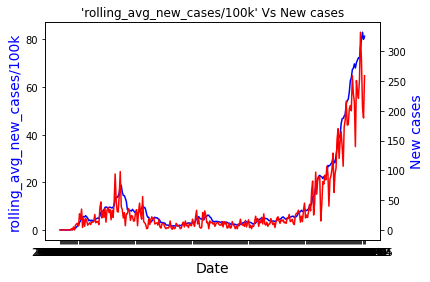

In [47]:
fig,ax = plt.subplots()
# make a plot
ax.plot(suffolk_county.Date, suffolk_county['rolling_avg_new_cases/100k'], color="blue")
# set x-axis label
ax.set_xlabel("Date",fontsize=14)
# set y-axis label
ax.set_ylabel("rolling_avg_new_cases/100k",color="blue",fontsize=14)
ax2=ax.twinx()
# make a plot with different y-axis using second axis object
ax2.plot(suffolk_county.Date, suffolk_county["New cases"],color="red")
ax2.set_ylabel("New cases",color="blue",fontsize=14)
plt.title("'rolling_avg_new_cases/100k' Vs New cases")

plt.show()

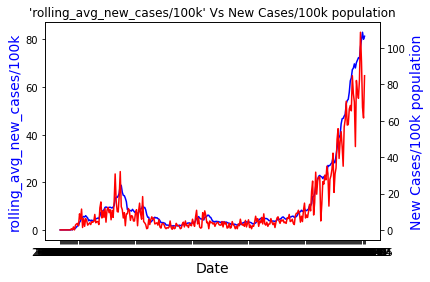

In [48]:
fig,ax = plt.subplots()
# make a plot
ax.plot(suffolk_county.Date, suffolk_county['rolling_avg_new_cases/100k'], color="blue")
# set x-axis label
ax.set_xlabel("Date",fontsize=14)
# set y-axis label
ax.set_ylabel("rolling_avg_new_cases/100k",color="blue",fontsize=14)
ax2=ax.twinx()
# make a plot with different y-axis using second axis object
ax2.plot(suffolk_county.Date, suffolk_county["New Cases/100k population"],color="red")
ax2.set_ylabel("New Cases/100k population",color="blue",fontsize=14)
plt.title("'rolling_avg_new_cases/100k' Vs New Cases/100k population")

plt.show()

## Export to CSV file to drive

In [49]:
print(CA_combined_data[CA_combined_data['growth_label'] == 'widespread'].shape)
print(CA_combined_data[CA_combined_data['growth_label'] == 'substantial'].shape)
print(CA_combined_data[CA_combined_data['growth_label'] == 'moderate'].shape)
print(CA_combined_data[CA_combined_data['growth_label'] == 'minimal'].shape)

(268, 18)
(2180, 18)
(3052, 18)
(12238, 18)


In [50]:
from datetime import datetime
location = '/content/drive/Shared drives/CMPE 295- Master Project/projectdata-2021/'
filename = 'NY_CombinedData_Labeled_CDCGuideline_'+datetime.now().strftime("%b%d")+'.csv' #%Y%m%d
print(filename)
CA_combined_data.to_csv(location+filename,index=False)

NY_CombinedData_Labeled_CDCGuideline_Feb07.csv


# 2. Loading Maryland Inertia

In [51]:
maryland_sd_inertia = pd.read_csv(location+'NY_processedMarylandData_Jan11.csv',low_memory=False)
maryland_sd_inertia.head()


,countyFIPS,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate
0,36001,Albany County,NY,305506,36001,Albany County,36,54,35,3.01,34.6,3.0,34.9,0.38,2.63,0,307117,-18.8,2020-01-01,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0
1,36001,Albany County,NY,305506,36001,Albany County,36,19,20,4.31,39.4,2.5,34.8,1.00,3.31,0,307117,2.3,2020-01-02,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0
2,36001,Albany County,NY,305506,36001,Albany County,36,17,20,4.47,39.5,2.4,41.4,1.01,3.46,0,307117,6.9,2020-01-03,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0
3,36001,Albany County,NY,305506,36001,Albany County,36,35,25,3.78,37.3,2.6,36.0,0.45,3.33,0,307117,2.9,2020-01-04,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0
4,36001,Albany County,NY,305506,36001,Albany County,36,46,30,3.30,34.8,2.8,36.5,0.39,2.90,0,307117,-10.4,2020-01-05,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,1.2,3.8,4.2,0.7,0.0


## Fixdate column of Social Distancing inertia

In [52]:
#old columns:

old_columns = ['CTFIPS', 'CTNAME', 'STFIPS', 'Social distancing index',
       '% staying home', 'Trips/person', '% out-of-county trips',
       '% out-of-state trips', 'Miles/person', 'Work trips/person',
       'Non-work trips/person', 'New COVID cases', 'Population',
       '% change in consumption', 'date', 'Transit mode share',
       '% people older than 60', 'Median income', '% African Americans',
       '% Hispanic Americans', '% Male', 'Population density',
       'Employment density', '# hot spots/1000 people',
       'Hospital beds/1000 people', 'ICUs/1000 people',
       '# contact tracing workers/1000 people', 'New cases/1000 people',
       'Active cases/1000 people', '#days: decreasing COVID cases',
       '% hospital bed utilization', 'Testing capacity',
       'Tests done/1000 people', '% ICU utilization', 'Ventilator shortage',
       'Imported COVID cases', 'COVID exposure/1000 people',
       '#days: decreasing ILI cases', 'Unemployment claims/1000 people',
       'Unemployment rate', '% working from home', 'Cumulative inflation rate',
       'COVID death rate']

In [53]:
maryland_sd_inertia.columns

Index(['countyFIPS', 'County Name', 'State', 'population', 'CTFIPS', 'CTNAME',
       'STFIPS', 'Social.distancing.index', 'X..staying.home', 'Trips.person',
       'X..out.of.county.trips', 'X..out.of.state.trips', 'Miles.person',
       'Work.trips.person', 'Non.work.trips.person', 'New.COVID.cases',
       'Population', 'X..change.in.consumption', 'date', 'Transit.mode.share',
       'X..people.older.than.60', 'Median.income', 'X..African.Americans',
       'X..Hispanic.Americans', 'X..Male', 'Population.density',
       'Employment.density', 'X..hot.spots.1000.people',
       'Hospital.beds.1000.people', 'ICUs.1000.people',
       'X..contact.tracing.workers.1000.people', 'New.cases.1000.people',
       'Active.cases.1000.people', 'X.days..decreasing.COVID.cases',
       'X..hospital.bed.utilization', 'Testing.capacity',
       'Tests.done.1000.people', 'X..ICU.utilization', 'Ventilator.shortage',
       'Imported.COVID.cases', 'COVID.exposure.1000.people',
       'X.days..decreasi

## Filter Data -CA State

In [54]:
maryland_sd_inertia.head(2)

,countyFIPS,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate
0,36001,Albany County,NY,305506,36001,Albany County,36,54,35,3.01,34.6,3.0,34.9,0.38,2.63,0,307117,-18.8,2020-01-01,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0
1,36001,Albany County,NY,305506,36001,Albany County,36,19,20,4.31,39.4,2.5,34.8,1.00,3.31,0,307117,2.3,2020-01-02,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0


In [55]:
maryland_sd_inertia.State.unique()

array(['NY'], dtype=object)

## 'New Cases/100k population'

In [56]:
maryland_sd_inertia.head(2)

,countyFIPS,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate
0,36001,Albany County,NY,305506,36001,Albany County,36,54,35,3.01,34.6,3.0,34.9,0.38,2.63,0,307117,-18.8,2020-01-01,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0
1,36001,Albany County,NY,305506,36001,Albany County,36,19,20,4.31,39.4,2.5,34.8,1.00,3.31,0,307117,2.3,2020-01-02,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0


In [57]:
maryland_sd_inertia['New Cases/100k population'] = maryland_sd_inertia['New.COVID.cases']*100000/ maryland_sd_inertia['population']
maryland_sd_inertia.tail(2)

,countyFIPS,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate,New Cases/100k population
22504,36123,Yates County,NY,24913,36123,Yates County,36,47,29,3.17,42.1,2.1,41.6,0.56,2.60,3,24841,-23.3,2020-12-27,0.34,27,54343,0.8,2.2,47.98,67,20,128,2.74,0.22,0.029,0.416,14.90,0,80.418891,3.7,1260.27,27.60,923,290,35.3,14,2.4,11.3,33.6,1.1,5.39,12.041906
22505,36123,Yates County,NY,24913,36123,Yates County,36,34,25,3.68,40.0,2.1,48.8,0.84,2.84,12,24841,-16.2,2020-12-28,0.34,27,54343,0.8,2.2,47.98,67,20,128,2.74,0.22,0.029,0.416,15.01,0,80.917348,3.8,1266.66,28.41,951,302,35.3,14,2.4,11.3,33.6,1.1,5.39,48.167623


## Computing rolling average

In [58]:
maryland_sd_inertia.columns

Index(['countyFIPS', 'County Name', 'State', 'population', 'CTFIPS', 'CTNAME',
       'STFIPS', 'Social.distancing.index', 'X..staying.home', 'Trips.person',
       'X..out.of.county.trips', 'X..out.of.state.trips', 'Miles.person',
       'Work.trips.person', 'Non.work.trips.person', 'New.COVID.cases',
       'Population', 'X..change.in.consumption', 'date', 'Transit.mode.share',
       'X..people.older.than.60', 'Median.income', 'X..African.Americans',
       'X..Hispanic.Americans', 'X..Male', 'Population.density',
       'Employment.density', 'X..hot.spots.1000.people',
       'Hospital.beds.1000.people', 'ICUs.1000.people',
       'X..contact.tracing.workers.1000.people', 'New.cases.1000.people',
       'Active.cases.1000.people', 'X.days..decreasing.COVID.cases',
       'X..hospital.bed.utilization', 'Testing.capacity',
       'Tests.done.1000.people', 'X..ICU.utilization', 'Ventilator.shortage',
       'Imported.COVID.cases', 'COVID.exposure.1000.people',
       'X.days..decreasi

In [59]:
maryland_sd_inertia.shape

(22506, 48)

In [60]:
col_idx = maryland_sd_inertia.columns.get_loc("New Cases/100k population")
print(col_idx)

47


47 no column  = New Cases/100k population

In [61]:
maryland_sd_inertia.iloc[:,col_idx]

0          0.000000
1          0.000000
2          0.000000
3          0.000000
4          0.000000
5          0.000000
6          0.000000
7          0.000000
8          0.000000
9          0.000000
10         0.000000
11         0.000000
12         0.000000
13         0.000000
14         0.000000
15         0.000000
16         0.000000
17         0.000000
18         0.000000
19         0.000000
20         0.000000
21         0.000000
22         0.000000
23         0.000000
24         0.000000
25         0.000000
26         0.000000
27         0.000000
28         0.000000
29         0.000000
30         0.000000
31         0.000000
32         0.000000
33         0.000000
34         0.000000
35         0.000000
36         0.000000
37         0.000000
38         0.000000
39         0.000000
40         0.000000
41         0.000000
42         0.000000
43         0.000000
44         0.000000
45         0.000000
46         0.000000
47         0.000000
48         0.000000
49         0.000000


In [62]:
maryland_sd_inertia.columns

Index(['countyFIPS', 'County Name', 'State', 'population', 'CTFIPS', 'CTNAME',
       'STFIPS', 'Social.distancing.index', 'X..staying.home', 'Trips.person',
       'X..out.of.county.trips', 'X..out.of.state.trips', 'Miles.person',
       'Work.trips.person', 'Non.work.trips.person', 'New.COVID.cases',
       'Population', 'X..change.in.consumption', 'date', 'Transit.mode.share',
       'X..people.older.than.60', 'Median.income', 'X..African.Americans',
       'X..Hispanic.Americans', 'X..Male', 'Population.density',
       'Employment.density', 'X..hot.spots.1000.people',
       'Hospital.beds.1000.people', 'ICUs.1000.people',
       'X..contact.tracing.workers.1000.people', 'New.cases.1000.people',
       'Active.cases.1000.people', 'X.days..decreasing.COVID.cases',
       'X..hospital.bed.utilization', 'Testing.capacity',
       'Tests.done.1000.people', 'X..ICU.utilization', 'Ventilator.shortage',
       'Imported.COVID.cases', 'COVID.exposure.1000.people',
       'X.days..decreasi

In [63]:
df = pd.DataFrame(columns=['County Name', 'State', 'population', 'CTFIPS', 'CTNAME','STFIPS',
       'Social.distancing.index', 'X..staying.home', 'Trips.person',
       'X..out.of.county.trips', 'X..out.of.state.trips', 'Miles.person',
       'Work.trips.person', 'Non.work.trips.person', 'New.COVID.cases',
       'Population', 'X..change.in.consumption', 'date', 'Transit.mode.share',
       'X..people.older.than.60', 'Median.income', 'X..African.Americans',
       'X..Hispanic.Americans', 'X..Male', 'Population.density',
       'Employment.density', 'X..hot.spots.1000.people',
       'Hospital.beds.1000.people', 'ICUs.1000.people',
       'X..contact.tracing.workers.1000.people', 'New.cases.1000.people',
       'Active.cases.1000.people', 'X.days..decreasing.COVID.cases',
       'X..hospital.bed.utilization', 'Testing.capacity',
       'Tests.done.1000.people', 'X..ICU.utilization', 'Ventilator.shortage',
       'Imported.COVID.cases', 'COVID.exposure.1000.people',
       'X.days..decreasing.ILI.cases', 'Unemployment.claims.1000.people',
       'Unemployment.rate', 'X..working.from.home','Cumulative.inflation.rate',
       'COVID.death.rate', 'New Cases/100k population','rolling_avg_new_cases/100k'])

In [64]:
# for reference; we don't use it
df_old = pd.DataFrame(columns=['State', 'Postal Code', 'STFIPS', 'CTFIPS', 'CTNAME',
       'Social distancing index', '% staying home', 'Trips/person',
       '% out-of-county trips', '% out-of-state trips', 'Miles/person',
       'Work trips/person', 'Non-work trips/person', 'New COVID cases',
       'Population', '% change in consumption', 'date', 'Transit mode share',
       '% people older than 60', 'Median income', '% African Americans',
       '% Hispanic Americans', '% Male', 'Population density',
       'Employment density', '# hot spots/1000 people',
       'Hospital beds/1000 people', 'ICUs/1000 people',
       '# contact tracing workers/1000 people', 'New cases/1000 people',
       'Active cases/1000 people', '#days: decreasing COVID cases',
       '% hospital bed utilization', 'Testing capacity',
       'Tests done/1000 people', '% ICU utilization', 'Ventilator shortage',
       'Imported COVID cases', 'COVID exposure/1000 people',
       '#days: decreasing ILI cases', 'Unemployment claims/1000 people',
       'Unemployment rate', '% working from home', 'Cumulative inflation rate',
       'COVID death rate', 'New Cases/100k population','rolling_avg_new_cases/100k'])


In [65]:
CA_counties = maryland_sd_inertia['CTNAME'].unique()

for county in CA_counties:
  county_data = maryland_sd_inertia[maryland_sd_inertia['CTNAME'] == county]
  #print(county_data.iloc[:,15])
  county_data['rolling_avg_new_cases/100k'] = county_data.iloc[:,col_idx].rolling(window=7).mean()
  df = df.append(county_data)

df.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate,New Cases/100k population,rolling_avg_new_cases/100k,countyFIPS
0,Albany County,NY,305506,36001,Albany County,36,54,35,3.01,34.6,3.0,34.9,0.38,2.63,0,307117,-18.8,2020-01-01,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,NaN,36001.0
1,Albany County,NY,305506,36001,Albany County,36,19,20,4.31,39.4,2.5,34.8,1.00,3.31,0,307117,2.3,2020-01-02,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,NaN,36001.0
2,Albany County,NY,305506,36001,Albany County,36,17,20,4.47,39.5,2.4,41.4,1.01,3.46,0,307117,6.9,2020-01-03,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,NaN,36001.0
3,Albany County,NY,305506,36001,Albany County,36,35,25,3.78,37.3,2.6,36.0,0.45,3.33,0,307117,2.9,2020-01-04,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,NaN,36001.0
4,Albany County,NY,305506,36001,Albany County,36,46,30,3.30,34.8,2.8,36.5,0.39,2.90,0,307117,-10.4,2020-01-05,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,1.2,3.8,4.2,0.7,0.0,0.0,NaN,36001.0


In [66]:
print(df.shape)
maryland_sd_inertia.shape

(22506, 49)


(22506, 48)

In [67]:
maryland_sd_inertia = df.copy()
maryland_sd_inertia

,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate,New Cases/100k population,rolling_avg_new_cases/100k,countyFIPS
0,Albany County,NY,305506,36001,Albany County,36,54,35,3.01,34.6,3.0,34.9,0.38,2.63,0,307117,-18.8,2020-01-01,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,0,2.3,3.8,4.2,0.7,0.00,0.000000,NaN,36001.0
1,Albany County,NY,305506,36001,Albany County,36,19,20,4.31,39.4,2.5,34.8,1.00,3.31,0,307117,2.3,2020-01-02,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,0,2.3,3.8,4.2,0.7,0.00,0.000000,NaN,36001.0
2,Albany County,NY,305506,36001,Albany County,36,17,20,4.47,39.5,2.4,41.4,1.01,3.46,0,307117,6.9,2020-01-03,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,0,2.3,3.8,4.2,0.7,0.00,0.000000,NaN,36001.0
3,Albany County,NY,305506,36001,Albany County,36,35,25,3.78,37.3,2.6,36.0,0.45,3.33,0,307117,2.9,2020-01-04,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,0,2.3,3.8,4.2,0.7,0.00,0.000000,NaN,36001.0
4,Albany County,NY,305506,36001,Albany County,36,46,30,3.30,34.8,2.8,36.5,0.39,2.90,0,307117,-10.4,2020-01-05,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,0,1.2,3.8,4.2,0.7,0.00,0.000000,NaN,36001.0
5,Albany County,NY,305506,36001,Albany County,36,24,22,4.13,39.1,2.3,32.8,1.02,3.11,0,307117,-3.9,2020-01-06,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,0,1.2,3.8,4.2,0.7,0.00,0.000000,NaN,36001.0
6,Albany County,NY,305506,36001,Albany County,36,16,20,4.35,38.9,2.0,38.2,1.08,3.26,0,307117,0.7,2020-01-07,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,7,1.2,3.8,4.2,0.7,0.00,0.000000,0.000000e+00,36001.0
7,Albany County,NY,305506,36001,Albany County,36,17,20,4.36,39.1,2.2,38.0,1.08,3.28,0,307117,1.3,2020-01-08,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,7,1.2,3.8,4.2,0.7,0.00,0.000000,0.000000e+00,36001.0
8,Albany County,NY,305506,36001,Albany County,36,17,20,4.45,39.1,2.2,38.2,1.08,3.37,0,307117,4.1,2020-01-09,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,7,1.2,3.8,4.2,0.7,0.00,0.000000,0.000000e+00,36001.0
9,Albany County,NY,305506,36001,Albany County,36,17,20,4.54,39.1,2.6,46.4,1.04,3.50,0,307117,8.1,2020-01-10,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0000,0.00,0,63.500000,0.0,0.00,0.00,0,0,0.00,7,1.2,3.8,4.2,0.7,0.00,0.000000,0.000000e+00,36001.0


In [68]:
maryland_sd_inertia[maryland_sd_inertia['date'] == '2020-08-01'].head(4)

,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate,New Cases/100k population,rolling_avg_new_cases/100k,countyFIPS
213,Albany County,NY,305506,36001,Albany County,36,34,28,4.32,33.3,2.4,37.5,0.38,3.94,12,307117,21.7,2020-08-01,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0380,1.04,3,64.250391,7.0,305.59,3.42,149,255,10.49,133,3.8,13.7,39.5,1.3,15.95,3.927910,3.600584e+00,36001.0
576,Allegany County,NY,46091,36003,Allegany County,36,21,17,4.65,34.8,5.3,65.2,0.36,4.30,0,46430,17.5,2020-08-01,0.50,25,47033,1.4,1.6,50.52,45,16,97,2.74,0.22,0.029,0.0000,1.04,12,64.250391,7.0,305.59,3.42,149,48,10.49,133,3.8,13.7,39.5,1.3,15.95,0.000000,3.806479e-16,36003.0
939,Bronx County,NY,1418207,36005,Bronx County,36,51,45,3.18,36.7,5.6,35.9,0.32,2.86,0,1432132,2.7,2020-08-01,59.89,17,38085,29.3,55.9,47.08,25037,5122,65,2.74,0.22,0.029,0.0000,1.04,190,64.250391,7.0,305.59,3.42,149,968,10.49,133,3.8,13.7,39.5,1.3,15.95,0.000000,0.000000e+00,36005.0
1302,Broome County,NY,190488,36007,Broome County,36,25,23,4.46,21.9,6.1,68.8,0.44,4.02,11,191659,22.6,2020-08-01,3.29,25,50859,5.2,4.1,49.18,272,136,116,2.74,0.22,0.029,0.0574,1.04,2,64.250391,7.0,305.59,3.42,149,119,10.49,133,3.8,13.7,39.5,1.3,15.95,5.774642,6.149619e+00,36007.0


## clean data - fill NA 

In [69]:
maryland_sd_inertia = maryland_sd_inertia.fillna(0)
maryland_sd_inertia.head(8)

,County Name,State,population,CTFIPS,CTNAME,STFIPS,Social.distancing.index,X..staying.home,Trips.person,X..out.of.county.trips,X..out.of.state.trips,Miles.person,Work.trips.person,Non.work.trips.person,New.COVID.cases,Population,X..change.in.consumption,date,Transit.mode.share,X..people.older.than.60,Median.income,X..African.Americans,X..Hispanic.Americans,X..Male,Population.density,Employment.density,X..hot.spots.1000.people,Hospital.beds.1000.people,ICUs.1000.people,X..contact.tracing.workers.1000.people,New.cases.1000.people,Active.cases.1000.people,X.days..decreasing.COVID.cases,X..hospital.bed.utilization,Testing.capacity,Tests.done.1000.people,X..ICU.utilization,Ventilator.shortage,Imported.COVID.cases,COVID.exposure.1000.people,X.days..decreasing.ILI.cases,Unemployment.claims.1000.people,Unemployment.rate,X..working.from.home,Cumulative.inflation.rate,COVID.death.rate,New Cases/100k population,rolling_avg_new_cases/100k,countyFIPS
0,Albany County,NY,305506,36001,Albany County,36,54,35,3.01,34.6,3.0,34.9,0.38,2.63,0,307117,-18.8,2020-01-01,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,0.0,36001.0
1,Albany County,NY,305506,36001,Albany County,36,19,20,4.31,39.4,2.5,34.8,1.00,3.31,0,307117,2.3,2020-01-02,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,0.0,36001.0
2,Albany County,NY,305506,36001,Albany County,36,17,20,4.47,39.5,2.4,41.4,1.01,3.46,0,307117,6.9,2020-01-03,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,0.0,36001.0
3,Albany County,NY,305506,36001,Albany County,36,35,25,3.78,37.3,2.6,36.0,0.45,3.33,0,307117,2.9,2020-01-04,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,2.3,3.8,4.2,0.7,0.0,0.0,0.0,36001.0
4,Albany County,NY,305506,36001,Albany County,36,46,30,3.30,34.8,2.8,36.5,0.39,2.90,0,307117,-10.4,2020-01-05,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,1.2,3.8,4.2,0.7,0.0,0.0,0.0,36001.0
5,Albany County,NY,305506,36001,Albany County,36,24,22,4.13,39.1,2.3,32.8,1.02,3.11,0,307117,-3.9,2020-01-06,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,0,1.2,3.8,4.2,0.7,0.0,0.0,0.0,36001.0
6,Albany County,NY,305506,36001,Albany County,36,16,20,4.35,38.9,2.0,38.2,1.08,3.26,0,307117,0.7,2020-01-07,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,7,1.2,3.8,4.2,0.7,0.0,0.0,0.0,36001.0
7,Albany County,NY,305506,36001,Albany County,36,17,20,4.36,39.1,2.2,38.0,1.08,3.28,0,307117,1.3,2020-01-08,6.06,22,64535,11.7,5.8,48.44,577,465,151,2.74,0.22,0.029,0.0,0.0,0,63.5,0.0,0.0,0.0,0,0,0.0,7,1.2,3.8,4.2,0.7,0.0,0.0,0.0,36001.0


## Labeling: Apply CDC Guideline for all counties

https://edsource.org/2020/quick-guide-what-californias-color-coded-county-tracking-system-means-for-schools/639357

In [70]:
county_names = maryland_sd_inertia['CTNAME'].unique()

* Widespread (purple): Counties with more than 7 daily new cases per 100,000 residents or higher than 8% positivity rate
* Substantial (red): 4 to 7 daily new cases per 100,000 residents or 5-8% positivity
* Moderate (orange): 1 to 3.9 daily new cases per 100,000 or 2-4.9% positivity
* Minimal (yellow): Less than 1 daily new case per 100,000 or less than 2% positivity

In [71]:
for county in county_names:   
    print('county :',county)
    county_population = maryland_sd_inertia[maryland_sd_inertia['CTNAME']== county].Population.unique()[0]
    county_data = maryland_sd_inertia[maryland_sd_inertia['CTNAME']== county]
    new_cases_100k_la_list = county_data['New Cases/100k population'].values
    diffArr = np.diff(new_cases_100k_la_list)
    


    diffArr = np.diff(new_cases_100k_la_list)
    growth_values =[]
    growth_values.append(0.0) # making first value as 0, as np.diff leaves first values as NA
    growth_values.extend(diffArr)
    county_data['growth_values'] = growth_values

    minVal = np.min(growth_values)
    maxVal = np.max(growth_values)
    meanVal= np.mean(growth_values, axis=0)
    stdVal = np.std(growth_values, axis=0)

#implementing cdc guideline-CA color code
#Widespread (purple): Counties with more than 7 daily new cases per 100,000 residents or higher than 8% positivity rate
#Substantial (red): 4 to 7 daily new cases per 100,000 residents or 5-8% positivity
#Moderate (orange): 1 to 3.9 daily new cases per 100,000 or 2-4.9% positivity
#Minimal (yellow): Less than 1 daily new case per 100,000 or less than 2% positivity
    for index, row in (county_data.iterrows()):
      i = row['rolling_avg_new_cases/100k']
      '''
      if i > 7 :
        label = 'widespread'
      elif (i <= 7) and (i >= 4):
        label = 'substantial'
      elif (i < 4) and (i >= 1):
        label = 'moderate'
      elif i < 1 :
        label = 'minimal'
        '''
      #labeling from CA
      if i > 69 :
        label = 'widespread'
      elif (i <= 69) and (i >= 19):
        label = 'substantial'
      elif (i < 19) and (i >= 7):
        label = 'moderate'
      elif i < 7 :
        label = 'minimal'  
    
      date = row['date']
      #print(i,county, date, label)

      df_index = (maryland_sd_inertia['CTNAME'] == county) & (maryland_sd_inertia['date'] == date) 
      #print(df_weekData)
      maryland_sd_inertia.loc[df_index,'growth_label'] = label
    #break

county : Albany County


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


county : Allegany County
county : Bronx County
county : Broome County
county : Cattaraugus County
county : Cayuga County
county : Chautauqua County
county : Chemung County
county : Chenango County
county : Clinton County
county : Columbia County
county : Cortland County
county : Delaware County
county : Dutchess County
county : Erie County
county : Essex County
county : Franklin County
county : Fulton County
county : Genesee County
county : Greene County
county : Hamilton County
county : Herkimer County
county : Jefferson County
county : Kings County
county : Lewis County
county : Livingston County
county : Madison County
county : Monroe County
county : Montgomery County
county : Nassau County
county : New York County
county : Niagara County
county : Oneida County
county : Onondaga County
county : Ontario County
county : Orange County
county : Orleans County
county : Oswego County
county : Otsego County
county : Putnam County
county : Queens County
county : Rensselaer County
county : R

In [72]:
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'widespread'].shape)
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'substantial'].shape)
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'moderate'].shape)
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'minimal'].shape)

(404, 50)
(2807, 50)
(2355, 50)
(16940, 50)


## Verifying the labeling with plot- Los Angeles

['minimal' 0 'moderate' 1 'substantial' 2 'widespread' 3]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


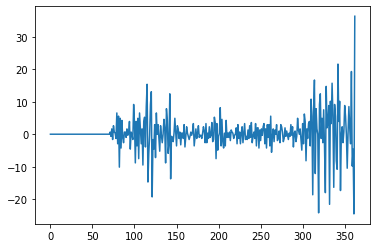

(2, 51)


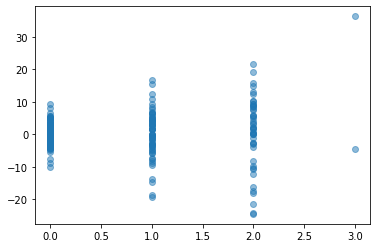

In [73]:
alameda_data = maryland_sd_inertia[maryland_sd_inertia['CTNAME'] == 'Albany County']

new_cases_100k_la_list = alameda_data['New Cases/100k population'].values
diffArr = np.diff(new_cases_100k_la_list)
growth_values =[]
growth_values.append(0.0) # making first value as 0, as np.diff leaves first values as NA
    
growth_values.extend(diffArr)

alameda_data['growth_code'] = alameda_data['growth_label'].astype('category').cat.codes
print(pd.unique(alameda_data[['growth_label', 'growth_code']].values.ravel()))
new_cases_100k_la_list = alameda_data['New Cases/100k population'].values
plt.plot(growth_values)
plt.show()
alameda_labelflat_growth = alameda_data[alameda_data['growth_label'] == 'widespread']
print(alameda_labelflat_growth.shape)
#alameda_labelflat_growth

N = 5
x = alameda_data['growth_code'].values
y = growth_values #alameda_data['New Cases/1k population'].values
colors = np.random.rand(N)
area = (30 * np.random.rand(N))**2  # 0 to 15 point radii

plt.scatter(x, y, alpha=0.5)
plt.show()


### ['minimal' 0 'moderate' 1 'substantial' 2 'widespread' 3]

widespread

In [74]:
maryland_sd_inertia[(maryland_sd_inertia['CTNAME'] == 'Los Angeles County') & (maryland_sd_inertia['growth_label'] == 'widespread')]['date'].unique()

array([], dtype=object)

substantial

In [75]:
maryland_sd_inertia[(maryland_sd_inertia['CTNAME'] == 'Los Angeles County') & (maryland_sd_inertia['growth_label'] == 'substantial')]['date'].unique()

array([], dtype=object)

moderate

In [76]:
maryland_sd_inertia[(maryland_sd_inertia['CTNAME'] == 'Los Angeles County') & (maryland_sd_inertia['growth_label'] == 'moderate')]['date'].unique()

array([], dtype=object)

minimal

In [77]:
maryland_sd_inertia[(maryland_sd_inertia['CTNAME'] == 'Los Angeles County') & (maryland_sd_inertia['growth_label'] == 'minimal')]['date'].unique()

array([], dtype=object)

## Verifying the labeling with plot- Reverside

In [78]:
maryland_sd_inertia['CTNAME'].unique()

array(['Albany County', 'Allegany County', 'Bronx County',
       'Broome County', 'Cattaraugus County', 'Cayuga County',
       'Chautauqua County', 'Chemung County', 'Chenango County',
       'Clinton County', 'Columbia County', 'Cortland County',
       'Delaware County', 'Dutchess County', 'Erie County',
       'Essex County', 'Franklin County', 'Fulton County',
       'Genesee County', 'Greene County', 'Hamilton County',
       'Herkimer County', 'Jefferson County', 'Kings County',
       'Lewis County', 'Livingston County', 'Madison County',
       'Monroe County', 'Montgomery County', 'Nassau County',
       'New York County', 'Niagara County', 'Oneida County',
       'Onondaga County', 'Ontario County', 'Orange County',
       'Orleans County', 'Oswego County', 'Otsego County',
       'Putnam County', 'Queens County', 'Rensselaer County',
       'Richmond County', 'Rockland County', 'St. Lawrence County',
       'Saratoga County', 'Schenectady County', 'Schoharie County',
     

['minimal' 0 'moderate' 1 'substantial' 2 'widespread' 3]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


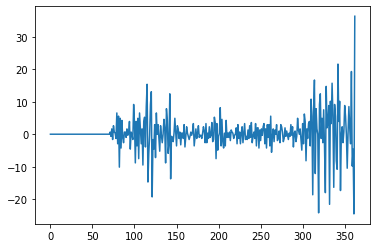

(2, 51)


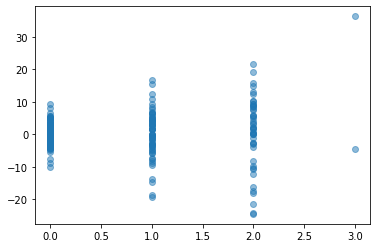

In [79]:
alameda_data = maryland_sd_inertia[maryland_sd_inertia['CTNAME'] == 'Albany County']

new_cases_100k_la_list = alameda_data['New Cases/100k population'].values
diffArr = np.diff(new_cases_100k_la_list)
growth_values =[]
growth_values.append(0.0) # making first value as 0, as np.diff leaves first values as NA
    
growth_values.extend(diffArr)

alameda_data['growth_code'] = alameda_data['growth_label'].astype('category').cat.codes
print(pd.unique(alameda_data[['growth_label', 'growth_code']].values.ravel()))
new_cases_100k_la_list = alameda_data['New Cases/100k population'].values
plt.plot(growth_values)
plt.show()
alameda_labelflat_growth = alameda_data[alameda_data['growth_label'] == 'widespread']
print(alameda_labelflat_growth.shape)
#alameda_labelflat_growth

N = 5
x = alameda_data['growth_code'].values
y = growth_values #alameda_data['New Cases/1k population'].values
colors = np.random.rand(N)
area = (30 * np.random.rand(N))**2  # 0 to 15 point radii

plt.scatter(x, y, alpha=0.5)
plt.show()


## Export to csv

In [80]:
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'widespread'].shape)
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'substantial'].shape)
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'moderate'].shape)
print(maryland_sd_inertia[maryland_sd_inertia['growth_label'] == 'minimal'].shape)

(404, 50)
(2807, 50)
(2355, 50)
(16940, 50)


In [81]:
from datetime import datetime
location = '/content/drive/Shared drives/CMPE 295- Master Project/projectdata-2021/'
filename = 'NY_MarylandData_Labeled_CDCGuideline_'+datetime.now().strftime("%b%d")+'.csv' #%Y%m%d
print(filename)
maryland_sd_inertia.to_csv(location+filename,index=False)

NY_MarylandData_Labeled_CDCGuideline_Feb07.csv
